# Using GraphSAGE to Generate Embeddings for Unseen Data

The GraphSAGE (SAmple and aggreGatE) algorithm [13] emerged in 2017 as a method for not only learning useful vertex embeddings, but also for predicting vertex embeddings on unseen vertices. This allows powerful high-level feature vectors to be produced for vertices which were not seen at train time; enabling us to effectively work with dynamic graphs, or very large graphs (>100, 000 vertices).


A GraphSAGE net is built up of k convolutional layers, called SageConv layers by the authors. Like other GNNs, they use a message-passing algorithm to combine neighbourhood features for each node. These features are then aggregated using a reduce function like max pool or mean.

## Setup
Here we load required libraries, define paths to data, and define some helper functions. **Feel free to skip this section.**

In [1]:
import numpy as np
import networkx as nx

from IPython.display import HTML
import matplotlib.animation as animation
import matplotlib.pyplot as plt

import dgl
import time

import torch
import torch.nn as nn
import torch.nn.functional as F

Using backend: pytorch


## Datasets

In this example we use the Cora dataset (see Figure 19) as provided by the deep learning library DGL.

The Cora dataset is oft considered ‘the MNIST of graph-based learning’ and consists of 2708 scientific publications (vertices), each classified into one of seven subfields in AI (or classes). Each vertex has a 1433 element binary feature vector, which indicates if each of the 1433 designated words appeared in the publication.

In [2]:
# To demonstrate let's use the Cora dataset
# DGL provides an api to access this and other datasets.
from dgl.data import citation_graph
data = citation_graph.CoraDataset()

There are 2708 nodes and 10556 edges
Each node has 1433 features
There are 7 classes


(array([298., 418., 818., 426., 217., 180., 351.]),
 array([0.        , 0.85714286, 1.71428571, 2.57142857, 3.42857143,
        4.28571429, 5.14285714, 6.        ]),
 <a list of 7 Patch objects>)

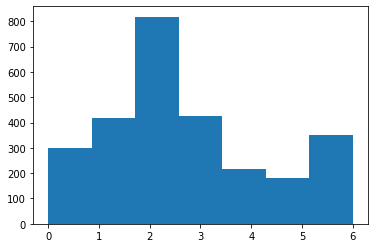

In [3]:
features = data.features
# that will download and cache the data for use later
# let's investigate
n_features = int(features.shape[1])
n_nodes = int(features.shape[0])
n_edges = data.graph.number_of_edges()

print(f'There are {n_nodes} nodes and {n_edges} edges')
print(f'Each node has {n_features} features')

# let's look at the labels, the classification target
labels = data.labels
n_classes = labels.max() + 1
print("There are {} classes".format(n_classes))
plt.hist(labels.flatten()[:20000], bins=n_classes)

In [4]:
# DGL datasets come preprepared with train/test/val splits, in the form of index masks
train_mask = data.train_mask
val_mask = data.val_mask
test_mask = data.test_mask
print(int(train_mask.sum()), 'train samples')
print(int(val_mask.sum()), 'validation samples')
print(int(test_mask.sum()), 'test samples')

140 train samples
300 validation samples
1000 test samples


In [5]:
# Let's convert the data from numpy arrays to the required pytorch tensors. 
features = torch.FloatTensor(features)
labels = torch.LongTensor(labels)
train_mask = torch.BoolTensor(train_mask)
val_mask = torch.BoolTensor(val_mask)
test_mask = torch.BoolTensor(test_mask)

In [6]:
# If we are using the gpu, we can send the arrays to gpu memory.
gpu = 0
if gpu >= 0:
    torch.cuda.set_device(gpu)
    features = features.cuda()
    labels = labels.cuda()
    train_mask = train_mask.cuda()
    val_mask = val_mask.cuda()
    test_mask = test_mask.cuda()   

A subgraph of the Cora dataset. The full Cora graph has N = 2708 and M = 5429. Note the many vertices with few incident edges (low degree) as compared to the few vertices with many incident edges (high degree).

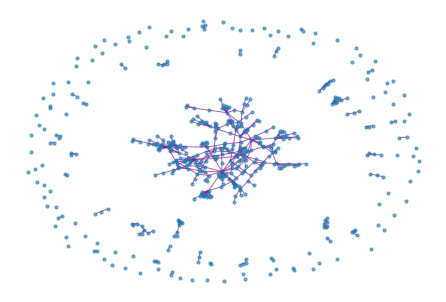

In [7]:
# DGL datasets come with a pre-initialised networkx graph
g = data.graph
# first remove any existing self-loops, because graphSAGE employs
# its own way of dealing with self-loops in the forward pass
g.remove_edges_from(nx.selfloop_edges(g))
# and lets recalc the num of edges for later
n_edges = g.number_of_edges()
# for simplicity lets convert the graph to an undirected one
g = g.to_undirected()

# with a networkx graph we can do some plotting
# lets just plot a fraction of the nodes
g_copy = g.copy()
g_copy.remove_nodes_from(range(500, n_nodes))
nx.draw(g_copy, node_size=10, alpha=0.6, arrows=False, edge_color='purple')

In [8]:
# We can build a trainable GNN out of this networkx graph with dgl/
# The DGLGraph can take a networkx graph as input
g = dgl.DGLGraph(g)

## Architecture and initial experiments

We'll start by setting up our own layers, models, and training routines.

In [9]:
# Like all layers and neural nets in pytorch we will inherit the Module class
class MeanAggSageLayer(nn.Module):
    def __init__(self, n_features_in, n_features_out):
        super(MeanAggSageLayer, self).__init__()
        # number of features coming in to this layer. If this is the first layer, 
        # this will be the amount of features per node
        self._in = n_features_in
        # the number of output features from this layer,
        # In the final layer of the GraphSAGE net this will equal n_classes 
        self._out = n_features_out
        # create a linear transformation between the input channels and the output.
        # These nn.Linear objects are shortcuts to hold the weights and biases
        # that are learnt through backpropogation, and applied
        # to incoming features. We will have one for self nodes 
        self.fc_self = nn.Linear(self._in, self._out)
        # and one for neighbour nodes 
        self.fc_neigh = nn.Linear(self._in, self._out)
        # we will initialise the weights with xavier_unform random
        # sampling, another name for Glorot uniform used in the original
        # graphsage paper
        gain = nn.init.calculate_gain('relu')   # sqrt(2)
        # set the gain appropriately for our activation function 
        nn.init.xavier_uniform_(self.fc_self.weight, gain=gain)
        nn.init.xavier_uniform_(self.fc_neigh.weight, gain=gain)
    
    def forward(self, graph, features):
        """
        The following code is DGL's way of using the graph class
        to facilitate message passing. The equivalent code in pure pytorch
        operating instead on the adjacency matrix adj and the feature matrix x would be:
            
            def forward(self, x, adj):
                return adj.matmul(x, reduce='mean') @ self_weights + x @ neigh_weights + bias
        
        """
        # set the incoming features matrix as the input to this layer 'h'
        graph.srcdata['h'] = features
        # create 2 user defined functions, the first to collect features 
        # from the src nodes 'h', send along edges 'm', and aggregate them at the 
        # destination nodes (the neighbours)
        features_from_src_nodes = dgl.function.copy_src('h', 'm')
        aggregation_at_dst_nodes = dgl.function.mean('m', 'neigh')
        # graph.update_all is a helper function to send the first function
        # along the edges and recieve the second function at the
        # destination nodes
        graph.update_all(features_from_src_nodes, aggregation_at_dst_nodes)
        # now we can get our aggregated neighbourhood features
        h_neigh = graph.dstdata['neigh']
        # and combine them with the src features (self loops)
        # fc_self(features) is equivalent to features @ weights + biases
        output = self.fc_self(features) + self.fc_neigh(h_neigh)
        # lastly we add a nonlinearity to the output enabling backpropogation
        output = F.relu(output)
        return output
    

The only method we need will be the 'self.forward' method (forward pass). The backpropogation will be handled by the library.

Now lets build a graphSAGE GNN out of these layers that takes in a DGLGraph we made previously.

In [10]:
class SimpleGraphSAGE(nn.Module):
    def __init__(
            self, 
            g, 
            n_features, 
            n_hidden, 
            n_classes, 
            n_layers
    ):
        super(SimpleGraphSAGE, self).__init__()
        # A ModuleList will hold all of our layers
        self.conv_layers = nn.ModuleList()
        self.g = g

        # input layer, the input size of which will be 
        # the number of features
        self.conv_layers.append(MeanAggSageLayer(n_features, n_hidden))
        # create the hidden layers: (n_layers - 1) allowing for the output layer
        for i in range(n_layers - 1):
            self.conv_layers.append(MeanAggSageLayer(n_hidden, n_hidden))
        # output layer, the output size of which will be the number of classes
        self.conv_layers.append(MeanAggSageLayer(n_hidden, n_classes))

    def forward(self, features):
        # h(0) will be equal to the feature matrix
        h = features
        for conv in self.conv_layers:
            # pass h through one layer and back into the next
            h = conv(self.g, h)
        # now we have h(k)
        return h

Before we create one of these models we need to decide on some params:


In [11]:
n_hidden = 16
n_layers = 2
learning_rate = 0.01
weight_decay = 0.0005
n_epochs = 120

Now we can create a GraphSAGE model using our graph (g)

In [12]:
model = SimpleGraphSAGE(g, n_features, n_hidden, n_classes, n_layers)
# we can send this to gpu memory as well
if gpu >= 0:
    model.cuda()

In [13]:
# use cross entropy loss function
loss_fcn = torch.nn.CrossEntropyLoss()

# use Adam Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate,
                             weight_decay=weight_decay)

In [14]:
# we also need a scoring function, lets create a simple accuracy calculator:
def get_accuracy(pred, true):
    _, indices = torch.max(pred, dim=1)
    correct = torch.sum(indices == true)
    return correct.item() * 1.0 / len(true)

And we can decide on a simple training routine too.

In [15]:
# now our training pipeline is able to be built
def train(model, optimizer, n_epochs):
    # we will keep track how long each epoch takes so we can calculate things like
    # Traversed Edges Per Second (TEPS)
    dur = []
    all_train_logits = []

    for epoch in range(n_epochs):

        # This doesnt train the mdoel, instead it tells all the child modules
        # that the model is in training mode and not evaluating mode
        # (for examplee, when evaluating, you dont want to apply dropout to the input tensor)
        model.train()
        t0 = time.time()

        # the forward pass - sending the features to the model.forward method
        output = model(features)
        # calculate our current loss by comparing only the training nodes'
        # prediction and truth
        output_train = output[train_mask]
        loss = loss_fcn(output_train, labels[train_mask])

        # the backwards pass! update the weights in our SAGELayers - but first:
        # reset the gradient back to 0 before doing backpropogation
        # (pytorch by default accumulates the gradients after each backward pass)
        optimizer.zero_grad()
        # backpropogation
        loss.backward()
        # step the adam optimizer forward
        optimizer.step()

        dur.append(time.time() - t0)

        # set the model into evaluation model
        model.eval()
        # temporatily turn off the gradient calculation as
        # just want to simply inference
        with torch.no_grad():
            output_val = output[val_mask]
            labels_val = labels[val_mask]
            acc = get_accuracy(output_val, labels_val)

        # record the output logits for plotting later
        all_train_logits.append(output_train)

        print("Epoch {:05d} | Time(s) {:.4f} | Loss {:.4f} | Accuracy {:.4f} | "
              "TEPS {:.2f}".format(epoch, np.mean(dur), loss.item(), acc, 
                                   n_edges / np.mean(dur)))

    print('training complete')
    return model, output, all_train_logits


In [16]:
model, last_output, _ = train(model, optimizer, n_epochs)

Epoch 00000 | Time(s) 0.3513 | Loss 1.9933 | Accuracy 0.1033 | TEPS 30045.94
Epoch 00001 | Time(s) 0.1781 | Loss 1.9336 | Accuracy 0.2000 | TEPS 59266.31
Epoch 00002 | Time(s) 0.1206 | Loss 1.9098 | Accuracy 0.1567 | TEPS 87550.96
Epoch 00003 | Time(s) 0.0917 | Loss 1.8938 | Accuracy 0.1567 | TEPS 115125.11
Epoch 00004 | Time(s) 0.0742 | Loss 1.8687 | Accuracy 0.1567 | TEPS 142291.11
Epoch 00005 | Time(s) 0.0626 | Loss 1.8287 | Accuracy 0.1567 | TEPS 168603.25
Epoch 00006 | Time(s) 0.0545 | Loss 1.7855 | Accuracy 0.1567 | TEPS 193795.74
Epoch 00007 | Time(s) 0.0484 | Loss 1.7421 | Accuracy 0.1933 | TEPS 218315.54
Epoch 00008 | Time(s) 0.0435 | Loss 1.6985 | Accuracy 0.2467 | TEPS 242605.95
Epoch 00009 | Time(s) 0.0396 | Loss 1.6576 | Accuracy 0.2500 | TEPS 266485.18
Epoch 00010 | Time(s) 0.0365 | Loss 1.6097 | Accuracy 0.2500 | TEPS 289519.25
Epoch 00011 | Time(s) 0.0338 | Loss 1.5648 | Accuracy 0.2533 | TEPS 312007.22
Epoch 00012 | Time(s) 0.0315 | Loss 1.5282 | Accuracy 0.2800 | TEPS

Epoch 00113 | Time(s) 0.0081 | Loss 0.6922 | Accuracy 0.4833 | TEPS 1309556.55
Epoch 00114 | Time(s) 0.0080 | Loss 0.6922 | Accuracy 0.4767 | TEPS 1314332.16
Epoch 00115 | Time(s) 0.0080 | Loss 0.6924 | Accuracy 0.4767 | TEPS 1318035.82
Epoch 00116 | Time(s) 0.0080 | Loss 0.6924 | Accuracy 0.4767 | TEPS 1321612.28
Epoch 00117 | Time(s) 0.0080 | Loss 0.6920 | Accuracy 0.4767 | TEPS 1326760.37
Epoch 00118 | Time(s) 0.0079 | Loss 0.6921 | Accuracy 0.4833 | TEPS 1332249.50
Epoch 00119 | Time(s) 0.0079 | Loss 0.6923 | Accuracy 0.4833 | TEPS 1337244.49
training complete


In [17]:
# now we can evaluate the model on the test set
output_test = last_output[test_mask]
labels_test = labels[test_mask]
acc = get_accuracy(output_test, labels_test)
print("Test Accuracy {:.4f}".format(acc))

Test Accuracy 0.5370


## Further experiments

Ok so not too impressive - how can we improve the model?

For one, there are other aggregation methods used in the original paper.
DGL has implemented a SAGEConv layer that takes our simplified SageLayer further:

In [18]:
from dgl.nn.pytorch.conv.sageconv import SAGEConv

In [19]:
# A new graphSAGE net could be built as follows:
class GraphSAGE(nn.Module):
    """
    GraphSAGE pytorch implementation from paper `Inductive Representation Learning on
    Large Graphs <https://arxiv.org/pdf/1706.02216.pdf>`__.
    """
    def __init__(
            self,
            g,
            n_features,
            n_hidden,
            n_classes,
            n_layers,
            agg,
            activation,
            dropout,
    ):
        super(GraphSAGE, self).__init__()
        self.layers = nn.ModuleList()
        self.g = g

        # input layer
        self.layers.append(
            SAGEConv(n_features, n_hidden, agg, feat_drop=dropout, activation=activation)
        )
        # hidden layers
        for i in range(n_layers - 1):
            self.layers.append(
                SAGEConv(n_hidden, n_hidden, agg, feat_drop=dropout, activation=activation)
            )
        # output layer
        self.layers.append(
            SAGEConv(n_hidden, n_classes, agg, feat_drop=dropout, activation=None)
        ) # no activation None for final layer

    def forward(self, features):
        h = features
        for layer in self.layers:
            h = layer(self.g, h)
        return h

The 'agg' variable can now be one of ['mean', 'gcn', 'pool', 'lstm'].
Additionally, a dropout fraction can be set, activation can be changed from 'relu', and the SAGEConv layer also supports an optional normalization function.

We'll start by looking at the **mean** aggregation function:

In [20]:
# lets try our same params as before but using a dropout value of 0.5
model = GraphSAGE(g, n_features, n_hidden, n_classes, n_layers, 'mean', F.relu, 0.5)
if gpu >= 0:
    model.cuda()
# initialize the optimzier again as the model params have changed
optimizer = torch.optim.Adam(
    model.parameters(), lr=learning_rate, weight_decay=weight_decay
)

In [21]:
model, last_output, all_train_logits = train(model, optimizer, n_epochs)

Epoch 00000 | Time(s) 0.0071 | Loss 2.0558 | Accuracy 0.1433 | TEPS 1485690.85
Epoch 00001 | Time(s) 0.0065 | Loss 1.9424 | Accuracy 0.1767 | TEPS 1614699.96
Epoch 00002 | Time(s) 0.0064 | Loss 1.8707 | Accuracy 0.2133 | TEPS 1659319.65
Epoch 00003 | Time(s) 0.0065 | Loss 1.7868 | Accuracy 0.2133 | TEPS 1632712.20
Epoch 00004 | Time(s) 0.0062 | Loss 1.7963 | Accuracy 0.2833 | TEPS 1711471.11
Epoch 00005 | Time(s) 0.0059 | Loss 1.7359 | Accuracy 0.3267 | TEPS 1782386.43
Epoch 00006 | Time(s) 0.0059 | Loss 1.7680 | Accuracy 0.3333 | TEPS 1796627.97
Epoch 00007 | Time(s) 0.0058 | Loss 1.7066 | Accuracy 0.3167 | TEPS 1809527.77
Epoch 00008 | Time(s) 0.0057 | Loss 1.7269 | Accuracy 0.3900 | TEPS 1851153.77
Epoch 00009 | Time(s) 0.0056 | Loss 1.6374 | Accuracy 0.3833 | TEPS 1885481.84
Epoch 00010 | Time(s) 0.0056 | Loss 1.5783 | Accuracy 0.4200 | TEPS 1883863.47
Epoch 00011 | Time(s) 0.0056 | Loss 1.5715 | Accuracy 0.4133 | TEPS 1884520.13
Epoch 00012 | Time(s) 0.0055 | Loss 1.5080 | Accurac

Epoch 00111 | Time(s) 0.0051 | Loss 0.2915 | Accuracy 0.6867 | TEPS 2053153.08
Epoch 00112 | Time(s) 0.0051 | Loss 0.2392 | Accuracy 0.7200 | TEPS 2053672.60
Epoch 00113 | Time(s) 0.0051 | Loss 0.1653 | Accuracy 0.7333 | TEPS 2053785.39
Epoch 00114 | Time(s) 0.0052 | Loss 0.2616 | Accuracy 0.6900 | TEPS 2048771.43
Epoch 00115 | Time(s) 0.0052 | Loss 0.2607 | Accuracy 0.7233 | TEPS 2041532.76
Epoch 00116 | Time(s) 0.0052 | Loss 0.1716 | Accuracy 0.7133 | TEPS 2043677.74
Epoch 00117 | Time(s) 0.0052 | Loss 0.2119 | Accuracy 0.7033 | TEPS 2046710.02
Epoch 00118 | Time(s) 0.0052 | Loss 0.1964 | Accuracy 0.7400 | TEPS 2046972.68
Epoch 00119 | Time(s) 0.0052 | Loss 0.2008 | Accuracy 0.7267 | TEPS 2046362.87
training complete


In [22]:
acc = get_accuracy(last_output[test_mask], labels_test)
print("Test Accuracy {:.4f}".format(acc))

Test Accuracy 0.6740


Slightly better! Lets change the aggregation function. 
in the original GraphSAGE paper they found the LSTM and pool methods generally outperformed the mean and GCN aggreation across a range of datasets.
Lets try the **pool** method (which refers to a max pool aggregator over the neighbourhood) and bump the number of hidden channels up.

In [23]:
model = GraphSAGE(g, n_features, 128, n_classes, 2, 'pool', F.relu, 0.3)
if gpu >= 0:
    model.cuda()
optimizer = torch.optim.Adam(
    model.parameters(), lr=0.003, weight_decay=weight_decay
)

In [24]:
model, last_output, all_train_logits = train(model, optimizer, n_epochs)

Epoch 00000 | Time(s) 0.0083 | Loss 2.0174 | Accuracy 0.1200 | TEPS 1277595.53
Epoch 00001 | Time(s) 0.0077 | Loss 1.8457 | Accuracy 0.3467 | TEPS 1363841.64
Epoch 00002 | Time(s) 0.0075 | Loss 1.8008 | Accuracy 0.3100 | TEPS 1411052.77
Epoch 00003 | Time(s) 0.0075 | Loss 1.8041 | Accuracy 0.3067 | TEPS 1410079.08
Epoch 00004 | Time(s) 0.0074 | Loss 1.7084 | Accuracy 0.3400 | TEPS 1419664.38
Epoch 00005 | Time(s) 0.0074 | Loss 1.5917 | Accuracy 0.3233 | TEPS 1428089.96
Epoch 00006 | Time(s) 0.0074 | Loss 1.5353 | Accuracy 0.3567 | TEPS 1433506.37
Epoch 00007 | Time(s) 0.0073 | Loss 1.3963 | Accuracy 0.4200 | TEPS 1443754.34
Epoch 00008 | Time(s) 0.0073 | Loss 1.4551 | Accuracy 0.3500 | TEPS 1446125.91
Epoch 00009 | Time(s) 0.0073 | Loss 1.2598 | Accuracy 0.4767 | TEPS 1449954.09
Epoch 00010 | Time(s) 0.0072 | Loss 1.1592 | Accuracy 0.5000 | TEPS 1457449.82
Epoch 00011 | Time(s) 0.0072 | Loss 1.0904 | Accuracy 0.5133 | TEPS 1459168.82
Epoch 00012 | Time(s) 0.0072 | Loss 0.9747 | Accurac

Epoch 00107 | Time(s) 0.0067 | Loss 0.0411 | Accuracy 0.7600 | TEPS 1568410.73
Epoch 00108 | Time(s) 0.0067 | Loss 0.0168 | Accuracy 0.7567 | TEPS 1568954.41
Epoch 00109 | Time(s) 0.0067 | Loss 0.0782 | Accuracy 0.6733 | TEPS 1569735.44
Epoch 00110 | Time(s) 0.0067 | Loss 0.0278 | Accuracy 0.7200 | TEPS 1569820.40
Epoch 00111 | Time(s) 0.0067 | Loss 0.0180 | Accuracy 0.7767 | TEPS 1570480.59
Epoch 00112 | Time(s) 0.0067 | Loss 0.0247 | Accuracy 0.7467 | TEPS 1571129.15
Epoch 00113 | Time(s) 0.0067 | Loss 0.0303 | Accuracy 0.7567 | TEPS 1571824.61
Epoch 00114 | Time(s) 0.0067 | Loss 0.0298 | Accuracy 0.7400 | TEPS 1572496.93
Epoch 00115 | Time(s) 0.0067 | Loss 0.0273 | Accuracy 0.7633 | TEPS 1572730.42
Epoch 00116 | Time(s) 0.0067 | Loss 0.0304 | Accuracy 0.7433 | TEPS 1573065.08
Epoch 00117 | Time(s) 0.0067 | Loss 0.0233 | Accuracy 0.7500 | TEPS 1573275.28
Epoch 00118 | Time(s) 0.0067 | Loss 0.0305 | Accuracy 0.7567 | TEPS 1573445.35
Epoch 00119 | Time(s) 0.0067 | Loss 0.0266 | Accurac

In [25]:
acc = get_accuracy(last_output[test_mask], labels_test)
print("Test Accuracy {:.4f}".format(acc))

Test Accuracy 0.7440


And finally the **LSTM** aggregation function:

In [33]:
model = GraphSAGE(g, n_features, 128, n_classes, 2, 'lstm', F.relu, 0.1)
if gpu >= 0:
    model.cuda()
optimizer = torch.optim.Adam(
    model.parameters(), lr=0.003, weight_decay=weight_decay
)

In [34]:
model, last_output, all_train_logits = train(model, optimizer, n_epochs)

Epoch 00000 | Time(s) 0.3460 | Loss 2.0057 | Accuracy 0.0967 | TEPS 30512.46
Epoch 00001 | Time(s) 0.3336 | Loss 1.8551 | Accuracy 0.3500 | TEPS 31641.23
Epoch 00002 | Time(s) 0.3284 | Loss 1.8039 | Accuracy 0.3033 | TEPS 32139.34
Epoch 00003 | Time(s) 0.3260 | Loss 1.7618 | Accuracy 0.3533 | TEPS 32382.68
Epoch 00004 | Time(s) 0.3243 | Loss 1.7365 | Accuracy 0.3767 | TEPS 32545.76
Epoch 00005 | Time(s) 0.3231 | Loss 1.6779 | Accuracy 0.3500 | TEPS 32667.21
Epoch 00006 | Time(s) 0.3223 | Loss 1.6484 | Accuracy 0.3200 | TEPS 32747.99
Epoch 00007 | Time(s) 0.3217 | Loss 1.7306 | Accuracy 0.3500 | TEPS 32813.20
Epoch 00008 | Time(s) 0.3212 | Loss 1.4687 | Accuracy 0.4300 | TEPS 32869.37
Epoch 00009 | Time(s) 0.3208 | Loss 1.4983 | Accuracy 0.4400 | TEPS 32903.87
Epoch 00010 | Time(s) 0.3235 | Loss 1.3894 | Accuracy 0.4600 | TEPS 32632.24
Epoch 00011 | Time(s) 0.3237 | Loss 1.3150 | Accuracy 0.4833 | TEPS 32610.46
Epoch 00012 | Time(s) 0.3237 | Loss 1.2075 | Accuracy 0.4900 | TEPS 32606.76

Epoch 00107 | Time(s) 0.3043 | Loss 0.0085 | Accuracy 0.7700 | TEPS 34688.19
Epoch 00108 | Time(s) 0.3044 | Loss 0.0122 | Accuracy 0.7600 | TEPS 34674.32
Epoch 00109 | Time(s) 0.3046 | Loss 0.0130 | Accuracy 0.7700 | TEPS 34660.66
Epoch 00110 | Time(s) 0.3047 | Loss 0.0130 | Accuracy 0.7500 | TEPS 34646.80
Epoch 00111 | Time(s) 0.3048 | Loss 0.0252 | Accuracy 0.7467 | TEPS 34634.26
Epoch 00112 | Time(s) 0.3049 | Loss 0.0196 | Accuracy 0.7433 | TEPS 34621.93
Epoch 00113 | Time(s) 0.3050 | Loss 0.0130 | Accuracy 0.7567 | TEPS 34609.54
Epoch 00114 | Time(s) 0.3051 | Loss 0.0121 | Accuracy 0.7400 | TEPS 34597.31
Epoch 00115 | Time(s) 0.3052 | Loss 0.0148 | Accuracy 0.7367 | TEPS 34585.32
Epoch 00116 | Time(s) 0.3053 | Loss 0.0125 | Accuracy 0.7433 | TEPS 34573.64
Epoch 00117 | Time(s) 0.3054 | Loss 0.0140 | Accuracy 0.7333 | TEPS 34562.07
Epoch 00118 | Time(s) 0.3055 | Loss 0.0166 | Accuracy 0.7467 | TEPS 34550.82
Epoch 00119 | Time(s) 0.3056 | Loss 0.0134 | Accuracy 0.7567 | TEPS 34539.08

In [35]:
acc = get_accuracy(last_output[test_mask], labels_test)
print("Test Accuracy {:.4f}".format(acc))

Test Accuracy 0.6830


Not bad! See how high you can get the accuracy with some tweaking. 
Compare against the state-of-the-art here: https://paperswithcode.com/sota/node-classification-on-cora

We can plot an animation of the predictions during training (although we are limited to 2D)

In [26]:
# one colour for each class
colors = ['red', 'green', 'blue', 'yellow', 'orange', 'purple', 'pink']
# to keep the graph small lets only consider training nodes
train_nodes = train_mask.cpu().numpy()
non_train = np.ones(len(train_nodes))
non_train[train_nodes] = 0
non_train = np.where(non_train)[0]
nx_g = model.g.to_networkx()
nx_g.remove_nodes_from(non_train)
rn_nodes = range(nx_g.number_of_nodes())

In [27]:
def draw_epoch(i):
    current_colors = []
    if gpu >= 0:
        logits = all_train_logits[i].detach().cpu().numpy()
    else:
        logits = all_train_logits[i].detach().numpy()
        
    max_ix = logits.argmax(axis=1)
    
    # choose x, y position based on the magntude of their highest 
    #min_ix = max_ix - 1
    #pos = {n: [logits[n, max_ix[n]], logits[n, min_ix[n]]] for n in rn_nodes}
    #node_size = 100
    # x=node_index, y = certainty, color=class 
    #pos = {n: [n, logits[n, max_ix[n]]] for n in rn_nodes}
    #node_size = 100
    
    # x=node_index, y = class, size = certainty
    pos = {n: [n, max_ix[n]] for n in rn_nodes}
    node_size = logits.max(axis=1) * 100
    
    cols = [colors[max_ix[n]] for n in rn_nodes]
    
    ax.cla()
    ax.axis('off')
    ax.set_title('Epoch: %d' % i)
    nx.draw_networkx(nx_g, pos, node_color=cols,
            with_labels=True, node_size=node_size, ax=ax, 
            edge_colors='purple', arrows=False, alpha=0.6)

fig = plt.figure(dpi=100)
fig.clf()
ax = fig.subplots()
draw_epoch(0)  # draw the prediction of the first epoch
plt.close()


In [28]:
ani = animation.FuncAnimation(fig, draw_epoch, frames=len(all_train_logits), interval=100)

In [29]:
HTML(ani.to_jshtml())

Note how the separation of the nodes into classes improves with more training epochs.